**t-SNE Visualization using RAPIDS**

This code uses GPU accelerated t-SNE method for data clustering and plotly for visualization.

In [1]:
# RAPIDS cuML kNN model
import cudf, cuml, cupy
print('cuML version',cuml.__version__)

import pickle
import numpy as np
from sklearn.model_selection import train_test_split
import gc

# Data manipulation
import pandas as pd # for data manipulation

# Visualization
import plotly.express as px # for data visualization
import matplotlib.pyplot as plt # for showing handwritten digits

from cuml.manifold import TSNE # for t-SNE dimensionality reduction

def unpickle(file):
    with open(file, 'rb') as f:
        dict = pickle.load(f, encoding="latin1")
    return dict

data_FULL_training = unpickle(r'../input/trimagi/training_x.dat') #Loads all unpickled raw data in datadict variable
Label_FULL_training = unpickle(r'../input/trimagi/training_y.dat') #Loads all unpickled raw data in datadict variable

data_Validation = unpickle(r'../input/trimagi/validation_x.dat') #Loads all unpickled raw Test data in datadict_tst variable
   
def DATA_Processing(data_list,class_list,validation_list):
    
    #Remove unformatted data
    remove_idx=[]
    for i in range(1,len(data_list)):
        if data_list[i].shape[0]!=8 or data_list[i].shape[1]!=8 or data_list[i].shape[2]!=3:
            #print(i)
            #print(data_list[i].shape)  
            remove_idx.append(i)

    for j in range(len(remove_idx)):    
        print("Removing value at index",remove_idx[j]) 
        #print(data_list[])
        remove=data_list.pop(remove_idx[j])
        remove=class_list.pop(remove_idx[j])


    data_list=np.array(data_list) 
    class_list=np.array(class_list)
    validation_list=np.array(validation_list)


    #8x8 image FILTERED TO 64 BIT vector
    data_list=data_list[:,:,:,0]
    data_list = data_list.reshape(data_list.shape[0], data_list.shape[1]*data_list.shape[2])
    #print(data_list[0])

    validation_list=validation_list[:,:,:,0]
    validation_list = validation_list.reshape(validation_list.shape[0], validation_list.shape[1]*validation_list.shape[2])
           
    return data_list,class_list,validation_list


X,Y,VALIDATION_TST = DATA_Processing(data_FULL_training,Label_FULL_training,data_Validation)

X = (X - np.min(X)) / (np.max(X) - np.min(X))
VALIDATION_TST = (VALIDATION_TST - np.min(VALIDATION_TST)) / (np.max(VALIDATION_TST) - np.min(VALIDATION_TST))


###SPLIT THE Training DATA

#X, Q_TST, Y, Q_Label = train_test_split(X, Y, test_size=0.05, random_state=0, stratify=Y)
#X, Q_TST, Y, Q_Label = train_test_split(X, Y, test_size=10000, train_size=50000, random_state=0, stratify=Y)

X = np.array(X).astype("float64")  
Y = np.array(Y).astype("float64") 

#Q_TST = np.array(Q_TST).astype("float32")
#Q_Label = np.array(Q_Label).astype("float32")


print("Training Dataset's Dimensions:" ,X.shape,"class Dim: ", Y.shape)
#print("Test Dataset's Dimensions:" ,Q_TST.shape,"class Dim: ", Q_Label.shape)
print()

print("Validation Dataset's Dimensions:" ,VALIDATION_TST.shape)

cuML version 21.10.02
Removing value at index 216805
Training Dataset's Dimensions: (1281166, 64) class Dim:  (1281166,)

Validation Dataset's Dimensions: (48238, 64)


In [2]:
VALIDATION_TST.shape

(48238, 64)

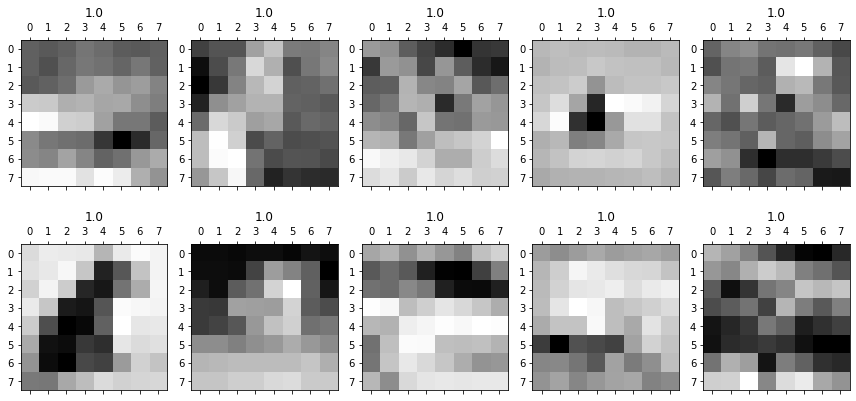

70

In [3]:
# Display images of the first 10 digits
X_vis = X.reshape(X.shape[0], 8,8)
fig, axs = plt.subplots(2, 5, sharey=False, tight_layout=True, figsize=(12,6), facecolor='white')
n=0
plt.gray() 
for i in range(0,2):
    for j in range(0,5):
        axs[i,j].matshow(X_vis[n])
        axs[i,j].set(title=Y[n])
        n=n+13000
plt.show() 
del X_vis
gc.collect()

**Configure TSNE for Training dataset using RAPIDS**

In [4]:
# Configure t-SNE function. 
embed = TSNE(
    n_components=2, # default=2, Dimension of the embedded space.
    perplexity=1000, # default=30.0, The perplexity is related to the number of nearest neighbors that is used in other manifold learning algorithms.
    early_exaggeration=12, # default=12.0, Controls how tight natural clusters in the original space are in the embedded space and how much space will be between them. 
    learning_rate=40, # default=200.0, The learning rate for t-SNE is usually in the range [10.0, 1000.0]. If the learning rate is too high, the data may look like a ‘ball’ with any point approximately equidistant from its nearest neighbours. If the learning rate is too low, most points may look compressed in a dense cloud with few outliers.
    n_iter=10000, # default=1000, Maximum number of iterations for the optimization. Should be at least 250.
    n_iter_without_progress=300, # default=300, Maximum number of iterations without progress before we abort the optimization, used after 250 initial iterations with early exaggeration. 
    min_grad_norm=0.0000001, # default=1e-7, If the gradient norm is below this threshold, the optimization will be stopped.
    metric='euclidean', # default=’euclidean’, The metric to use when calculating distance between instances in a feature array.
    init='random', # {‘random’, ‘pca’} or ndarray of shape (n_samples, n_components), default=’random’. Initialization of embedding
    verbose=0, # default=0, Verbosity level.
    random_state=42, # RandomState instance or None, default=None. Determines the random number generator. Pass an int for reproducible results across multiple function calls.
    method='barnes_hut', # default=’barnes_hut’. By default the gradient calculation algorithm uses Barnes-Hut approximation running in O(NlogN) time. method=’exact’ will run on the slower, but exact, algorithm in O(N^2) time. The exact algorithm should be used when nearest-neighbor errors need to be better than 3%. 
    angle=0.5, # default=0.5, Only used if method=’barnes_hut’ This is the trade-off between speed and accuracy for Barnes-Hut T-SNE.
    )

# Transform X
X_embedded = embed.fit_transform(X)

# Print results
#print('New Shape of X: ', X_embedded.shape)

#print('No. of iterations: ', embed.n_iter_)
#print('Kullback-Leibler divergence after optimization: ', embed.kl_divergence_)
#print('Embedding vectors: ', embed.embedding_)

In [5]:
##### Create a scatter plot

fig = px.scatter(None, x=X_embedded[:,0], y=X_embedded[:,1], 
                 labels={
                     "x": "Dimension 1",
                     "y": "Dimension 2",
                 },
                 opacity=1, color=Y.astype(str))

# Change chart background color
fig.update_layout(dict(plot_bgcolor = 'white'))

# Update axes lines
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

# Set figure title
fig.update_layout(title_text="t-SNE")

# Update marker size
fig.update_traces(marker=dict(size=3))

fig.show()

**Trying this on Validation (Prediction dataset)**

In [6]:
# Configure t-SNE function. 
embed = TSNE(
    n_components=2, # default=2, Dimension of the embedded space.
    perplexity=1000, # default=30.0, The perplexity is related to the number of nearest neighbors that is used in other manifold learning algorithms.
    early_exaggeration=12, # default=12.0, Controls how tight natural clusters in the original space are in the embedded space and how much space will be between them. 
    learning_rate=40, # default=200.0, The learning rate for t-SNE is usually in the range [10.0, 1000.0]. If the learning rate is too high, the data may look like a ‘ball’ with any point approximately equidistant from its nearest neighbours. If the learning rate is too low, most points may look compressed in a dense cloud with few outliers.
    n_iter=10000, # default=1000, Maximum number of iterations for the optimization. Should be at least 250.
    n_iter_without_progress=300, # default=300, Maximum number of iterations without progress before we abort the optimization, used after 250 initial iterations with early exaggeration. 
    min_grad_norm=0.0000001, # default=1e-7, If the gradient norm is below this threshold, the optimization will be stopped.
    metric='euclidean', # default=’euclidean’, The metric to use when calculating distance between instances in a feature array.
    init='random', # {‘random’, ‘pca’} or ndarray of shape (n_samples, n_components), default=’random’. Initialization of embedding
    verbose=0, # default=0, Verbosity level.
    random_state=42, # RandomState instance or None, default=None. Determines the random number generator. Pass an int for reproducible results across multiple function calls.
    method='barnes_hut', # default=’barnes_hut’. By default the gradient calculation algorithm uses Barnes-Hut approximation running in O(NlogN) time. method=’exact’ will run on the slower, but exact, algorithm in O(N^2) time. The exact algorithm should be used when nearest-neighbor errors need to be better than 3%. 
    angle=0.5, # default=0.5, Only used if method=’barnes_hut’ This is the trade-off between speed and accuracy for Barnes-Hut T-SNE.
    )

# Transform X
X_embedded = embed.fit_transform(VALIDATION_TST)

# Print results
#print('New Shape of X: ', X_embedded.shape)

#print('No. of iterations: ', embed.n_iter_)
#print('Kullback-Leibler divergence after optimization: ', embed.kl_divergence_)
#print('Embedding vectors: ', embed.embedding_)

fig = px.scatter(None, x=X_embedded[:,0], y=X_embedded[:,1], 
                 labels={
                     "x": "Dimension 1",
                     "y": "Dimension 2",
                 },
                 opacity=1)
# Set figure title
fig.update_layout(title_text="t-SNE on Validation set")

# Update marker size
fig.update_traces(marker=dict(size=3))

fig.show()